In [39]:
experiment='run_330d_iabp9'

In [40]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib
from matplotlib.tri import Triangulation
from matplotlib import cm, patches, collections

from pynextsim import NextsimBin
from pynextsim.nextsim_mesh import NextsimMesh

from pynextsim.gmshlib import GmshMesh

from pynextsim.drifter_time_series import *
import pynextsim.lib as nsl

import pandas as pd
import os

%matplotlib notebook

In [41]:
mesh_file='/data/experiments/'+experiment+'/mesh_crash.bin'
mesh = NextsimMesh(mesh_file)

In [42]:
mesh.mapping


<Other Coordinate Operation Transformer: stere>
Description: PROJ-based coordinate operation
Area of Use:
- undefined

In [43]:
field_file='/data/experiments/'+experiment+'/field_crash.bin'
field = NextsimBin(field_file)

In [44]:
drifters_file='/data/experiments/'+experiment+'/IABP_Drifters_20060202.txt'

In [45]:
df = pd.read_csv(drifters_file, delimiter=r"\s+")

In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1999 entries, 0 to 1998
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Year           1999 non-null   int64  
 1   Month          1999 non-null   int64  
 2   Day            1999 non-null   int64  
 3   Hour           1999 non-null   int64  
 4   BuoyID         1999 non-null   int64  
 5   Lat            1999 non-null   float64
 6   Lon            1999 non-null   float64
 7   Concentration  1999 non-null   float64
dtypes: float64(3), int64(5)
memory usage: 125.1 KB


In [47]:
df.head()

,Year,Month,Day,Hour,BuoyID,Lat,Lon,Concentration
0,2006,2,2,0,1907,81.979,-127.722,0.99513
1,2006,2,2,0,2415,77.022,-140.799,0.99703
2,2006,2,2,0,2416,73.552,-140.754,0.99617
3,2006,2,2,0,2417,75.104,-141.579,0.99637
4,2006,2,2,0,2419,75.817,-146.290,0.99603


In [48]:
drifters_position = df[["BuoyID","Lat","Lon"]]

In [49]:
list_buoys = df['BuoyID'].tolist()
list_red = list(dict.fromkeys(list_buoys))
print(len(list_buoys),len(list_red))

1999 24


In [50]:
os.mkdir('/data/experiments/'+experiment+'/drifters')
for i in np.arange(len(list_red)):
    print(list_red[i])
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    np.savez('/data/experiments/'+experiment+'/drifters/drifter_'+str(list_red[i]), X,Y)

1907
2415
2416
2417
2419
3691
3692
3981
5317
7440
7948
7949
7950
22068
22082
22086
24224
25752
25820
25887
53537
53541
23678
1908


In [51]:
print(np.min(X), np.max(X), np.min(Y),np.max(Y))

-1536015.1815076612 -1487935.9349315637 372461.77083135286 404837.1981589003


In [52]:
!ls /data/experiments/$experiment/drifters/

drifter_1907.npz   drifter_2415.npz   drifter_25820.npz  drifter_53537.npz
drifter_1908.npz   drifter_2416.npz   drifter_25887.npz  drifter_53541.npz
drifter_22068.npz  drifter_2417.npz   drifter_3691.npz	 drifter_7440.npz
drifter_22082.npz  drifter_2419.npz   drifter_3692.npz	 drifter_7948.npz
drifter_22086.npz  drifter_24224.npz  drifter_3981.npz	 drifter_7949.npz
drifter_23678.npz  drifter_25752.npz  drifter_5317.npz	 drifter_7950.npz


<IPython.core.display.Javascript object>


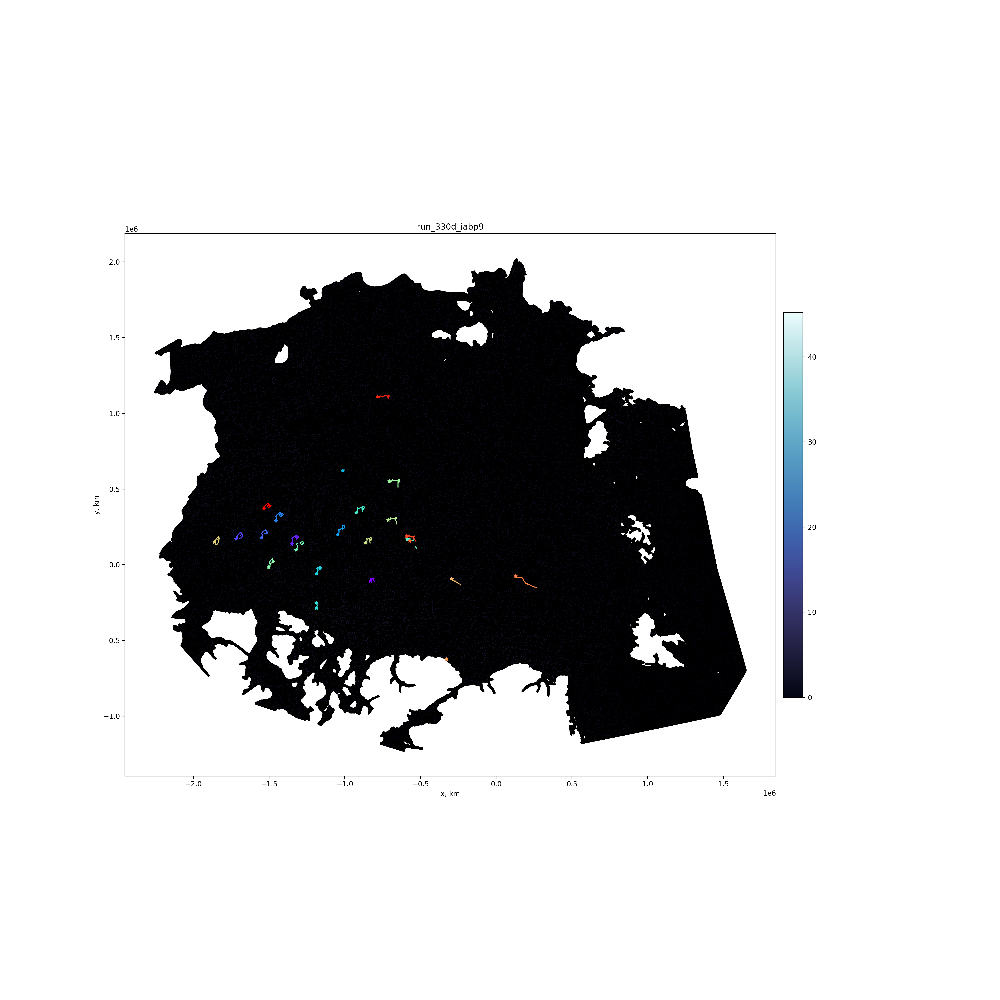

In [53]:
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
fig = ax.figure

sfac=1
cmap='ice'
cmap2 = cm.get_cmap('rainbow', len(list_red))

#mesh parameters
nodes_x, nodes_y = mesh.get_nodes_xy()
indices = mesh.get_indices("triangles", numbering='gmsh', asvector=False)
Nn = mesh.num_nodes
Ne = mesh.num_triangles

patch_list  = []

for inds in indices:
    ccl   = []
    for n in inds:
        ccl.append((sfac*nodes_x[n],sfac*nodes_y[n]))
    ccl.append(ccl[0]) # close the contour
    patch_list.append(patches.Polygon(ccl,True,linewidth=0))

pc = collections.PatchCollection(patch_list, cmap=cmap, alpha=1)

#data to fill
thick = field.get_var('Thickness')
data = thick

pc.set_array(data)
pc.set_edgecolor('k')

ax.add_collection(pc)

for i in np.arange(len(list_red)):
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    ax.plot(X[0],Y[0],'*',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=5)
    for x, y in zip(X, Y):
        ax.plot(x,y,'.',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=1)
        
ax.set_xlabel('x, km')
ax.set_ylabel('y, km')

#-1329165.3868372526 -1183291.2684376023 94884.00886036998 225761.49111683283
#ax.set_ylim([-1.5e6,1e6])
#ax.set_xlim([-2e6,1.5e5])
ax.set_aspect('equal')

cbar  = fig.colorbar(pc, ax=ax, orientation="vertical", pad=0.01, shrink=0.5)
plt.title(experiment)
plt.savefig('/plots/plots/map_drifters_iabp_on_iconc_mesh'+experiment+'.png')

<IPython.core.display.Javascript object>


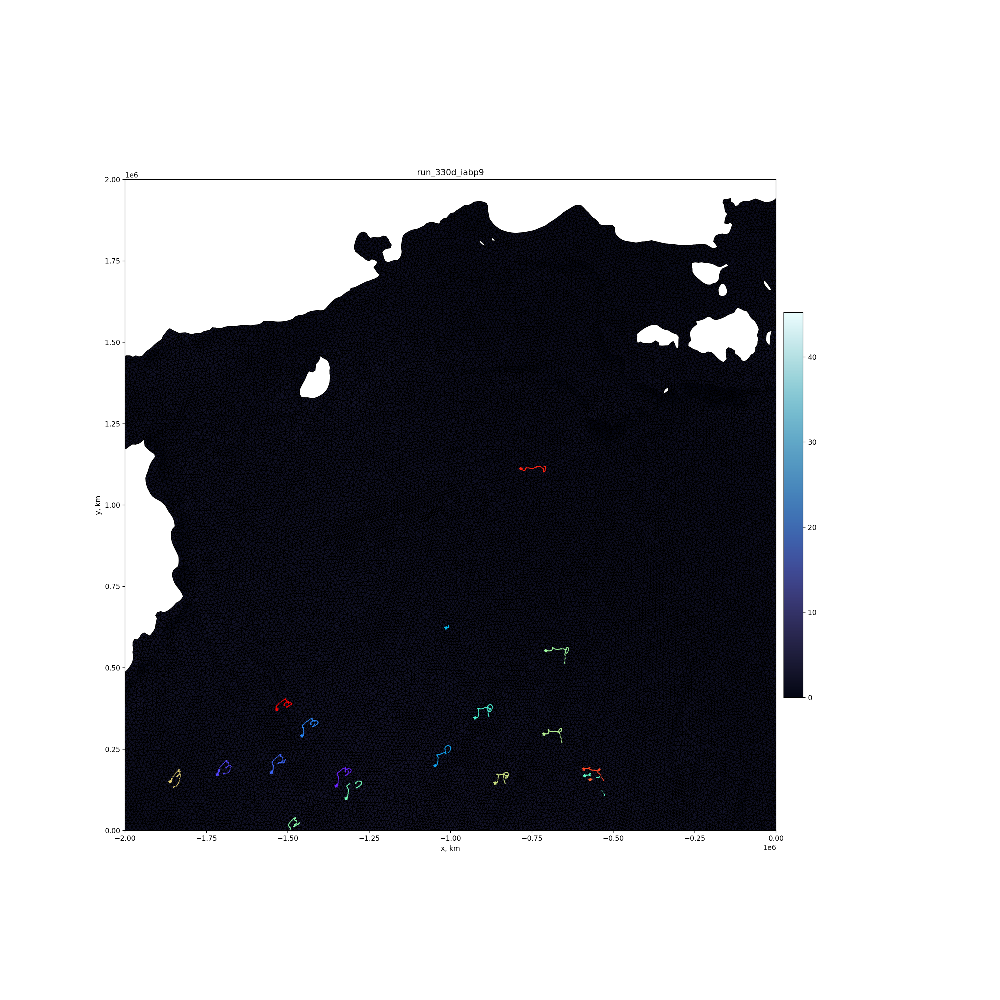

In [54]:
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
fig = ax.figure

sfac=1
cmap='ice'
cmap2 = cm.get_cmap('rainbow', len(list_red))

#mesh parameters
nodes_x, nodes_y = mesh.get_nodes_xy()
indices = mesh.get_indices("triangles", numbering='gmsh', asvector=False)
Nn = mesh.num_nodes
Ne = mesh.num_triangles

patch_list  = []

for inds in indices:
    ccl   = []
    for n in inds:
        ccl.append((sfac*nodes_x[n],sfac*nodes_y[n]))
    ccl.append(ccl[0]) # close the contour
    patch_list.append(patches.Polygon(ccl,True,linewidth=0))

pc = collections.PatchCollection(patch_list, cmap=cmap, alpha=1)

#data to fill
thick = field.get_var('Thickness')
data = thick

pc.set_array(data)
pc.set_edgecolor('k')

ax.add_collection(pc)

for i in np.arange(len(list_red)):
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    ax.plot(X[0],Y[0],'*',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=5)
    for x, y in zip(X, Y):
        ax.plot(x,y,'.',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=1)
        
ax.set_xlabel('x, km')
ax.set_ylabel('y, km')

#-1329165.3868372526 -1183291.2684376023 94884.00886036998 225761.49111683283
ax.set_ylim([0,2e6])
ax.set_xlim([-2e6,0])
ax.set_aspect('equal')

cbar  = fig.colorbar(pc, ax=ax, orientation="vertical", pad=0.01, shrink=0.5)
plt.title(experiment)
plt.savefig('/plots/plots/map_drifters_iabp_on_iconc_mesh'+experiment+'_quart1.png')

<IPython.core.display.Javascript object>


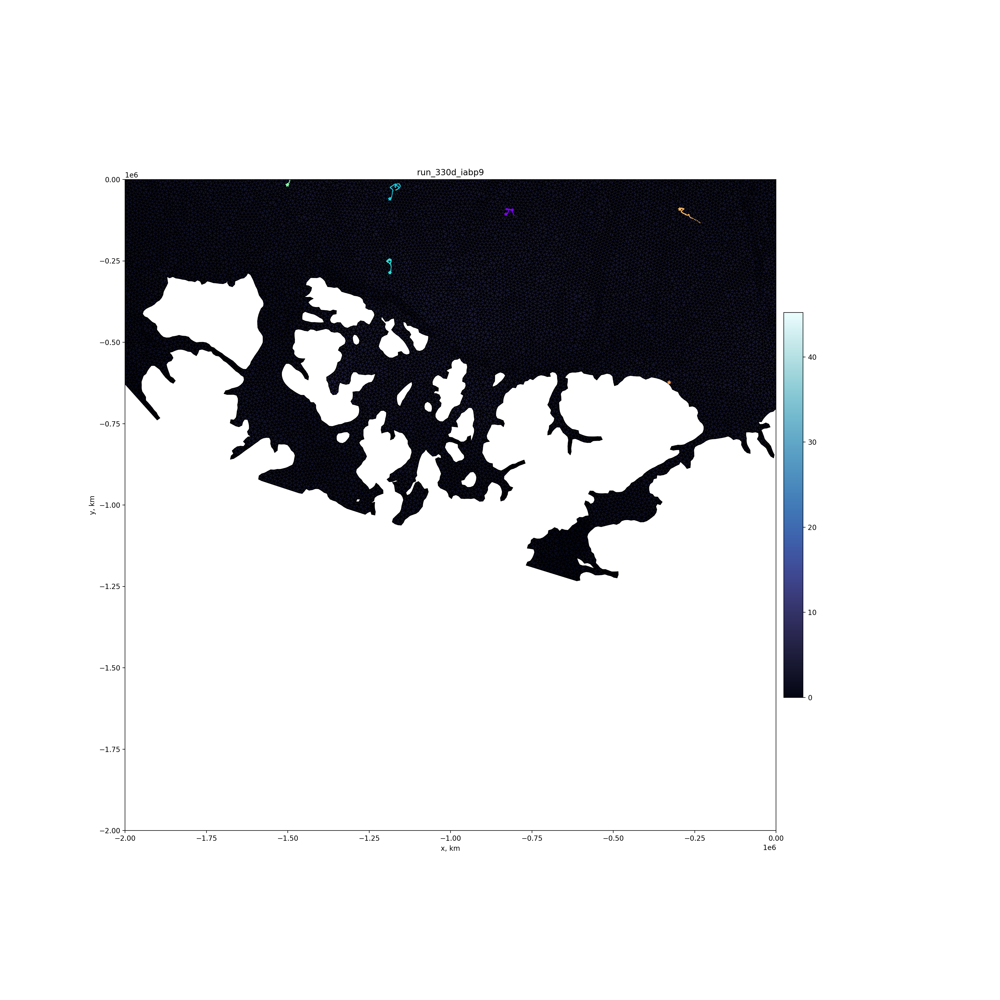

In [55]:
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
fig = ax.figure

sfac=1
cmap='ice'
cmap2 = cm.get_cmap('rainbow', len(list_red))

#mesh parameters
nodes_x, nodes_y = mesh.get_nodes_xy()
indices = mesh.get_indices("triangles", numbering='gmsh', asvector=False)
Nn = mesh.num_nodes
Ne = mesh.num_triangles

patch_list  = []

for inds in indices:
    ccl   = []
    for n in inds:
        ccl.append((sfac*nodes_x[n],sfac*nodes_y[n]))
    ccl.append(ccl[0]) # close the contour
    patch_list.append(patches.Polygon(ccl,True,linewidth=0))

pc = collections.PatchCollection(patch_list, cmap=cmap, alpha=1)

#data to fill
thick = field.get_var('Thickness')
data = thick

pc.set_array(data)
pc.set_edgecolor('k')

ax.add_collection(pc)

for i in np.arange(len(list_red)):
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    ax.plot(X[0],Y[0],'*',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=5)
    for x, y in zip(X, Y):
        ax.plot(x,y,'.',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=1)
        
ax.set_xlabel('x, km')
ax.set_ylabel('y, km')

#-1329165.3868372526 -1183291.2684376023 94884.00886036998 225761.49111683283
ax.set_ylim([-2e6,0])
ax.set_xlim([-2e6,0])
ax.set_aspect('equal')

cbar  = fig.colorbar(pc, ax=ax, orientation="vertical", pad=0.01, shrink=0.5)
plt.title(experiment)
plt.savefig('/plots/plots/map_drifters_iabp_on_iconc_mesh'+experiment+'_quart2.png')

<IPython.core.display.Javascript object>


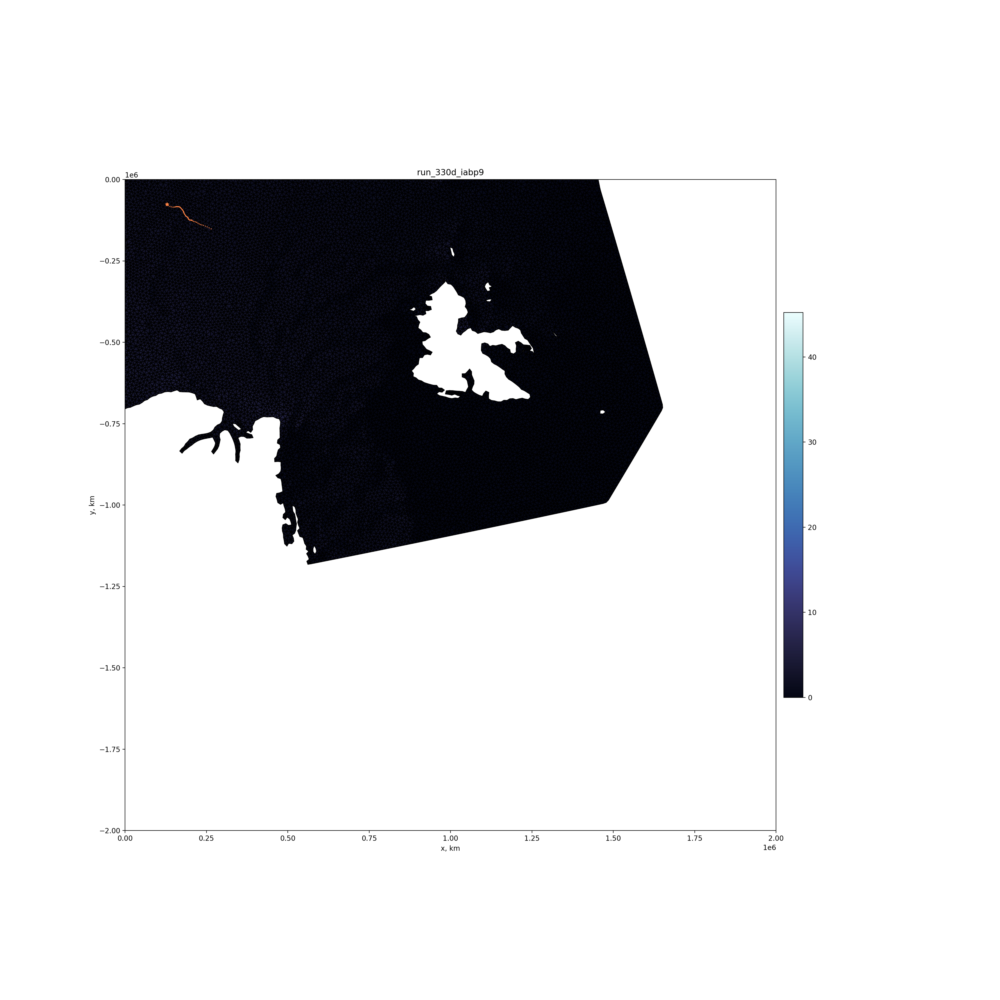

In [56]:
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
fig = ax.figure

sfac=1
cmap='ice'
cmap2 = cm.get_cmap('rainbow', len(list_red))

#mesh parameters
nodes_x, nodes_y = mesh.get_nodes_xy()
indices = mesh.get_indices("triangles", numbering='gmsh', asvector=False)
Nn = mesh.num_nodes
Ne = mesh.num_triangles

patch_list  = []

for inds in indices:
    ccl   = []
    for n in inds:
        ccl.append((sfac*nodes_x[n],sfac*nodes_y[n]))
    ccl.append(ccl[0]) # close the contour
    patch_list.append(patches.Polygon(ccl,True,linewidth=0))

pc = collections.PatchCollection(patch_list, cmap=cmap, alpha=1)

#data to fill
thick = field.get_var('Thickness')
data = thick

pc.set_array(data)
pc.set_edgecolor('k')

ax.add_collection(pc)

for i in np.arange(len(list_red)):
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    ax.plot(X[0],Y[0],'*',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=5)
    for x, y in zip(X, Y):
        ax.plot(x,y,'.',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=1)
        
ax.set_xlabel('x, km')
ax.set_ylabel('y, km')

#-1329165.3868372526 -1183291.2684376023 94884.00886036998 225761.49111683283
ax.set_ylim([-2e6,0])
ax.set_xlim([0,2e6])
ax.set_aspect('equal')

cbar  = fig.colorbar(pc, ax=ax, orientation="vertical", pad=0.01, shrink=0.5)
plt.title(experiment)
plt.savefig('/plots/plots/map_drifters_iabp_on_iconc_mesh'+experiment+'_quart3.png')

<IPython.core.display.Javascript object>


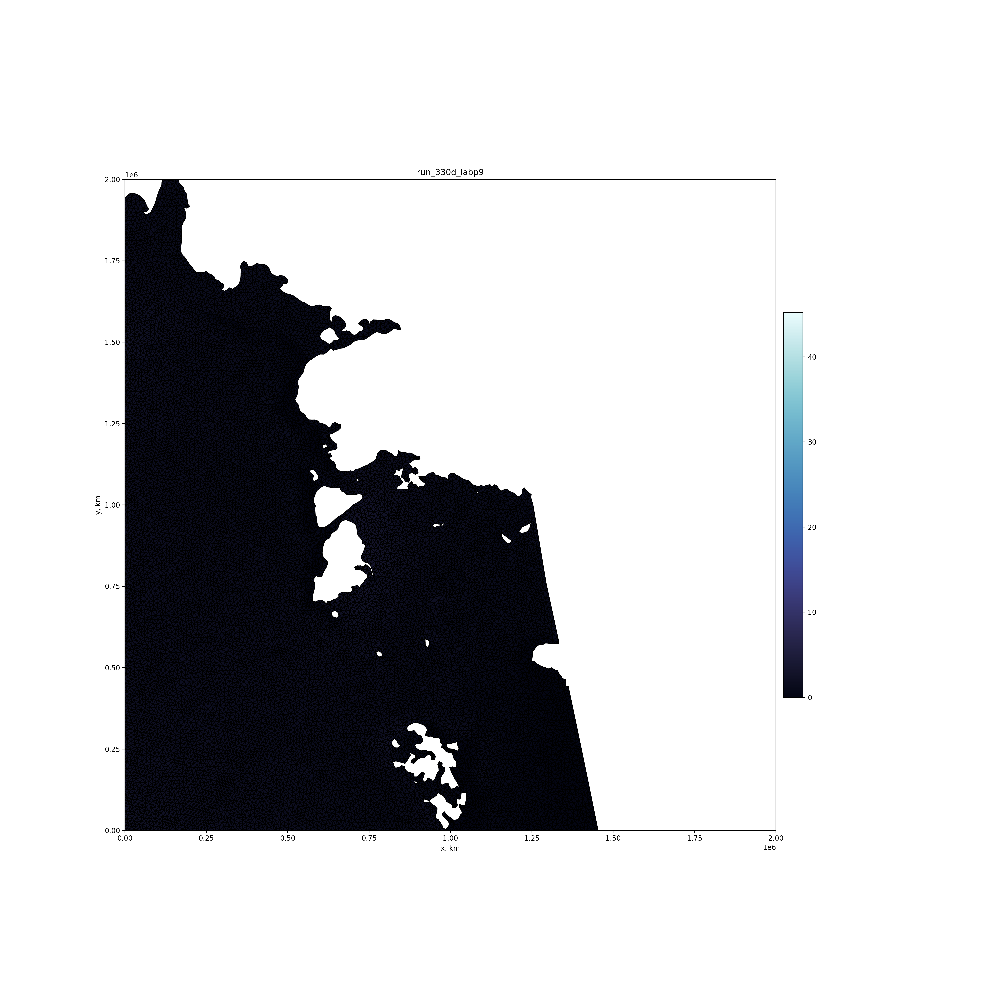

In [57]:
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
fig = ax.figure

sfac=1
cmap='ice'
cmap2 = cm.get_cmap('rainbow', len(list_red))

#mesh parameters
nodes_x, nodes_y = mesh.get_nodes_xy()
indices = mesh.get_indices("triangles", numbering='gmsh', asvector=False)
Nn = mesh.num_nodes
Ne = mesh.num_triangles

patch_list  = []

for inds in indices:
    ccl   = []
    for n in inds:
        ccl.append((sfac*nodes_x[n],sfac*nodes_y[n]))
    ccl.append(ccl[0]) # close the contour
    patch_list.append(patches.Polygon(ccl,True,linewidth=0))

pc = collections.PatchCollection(patch_list, cmap=cmap, alpha=1)

#data to fill
thick = field.get_var('Thickness')
data = thick

pc.set_array(data)
pc.set_edgecolor('k')

ax.add_collection(pc)

for i in np.arange(len(list_red)):
    pos_buoy=drifters_position.loc[drifters_position['BuoyID'] == list_red[i]]
    shp = pos_buoy['Lon'].shape
    X = np.nan*np.ones(shape=shp)
    Y = np.nan*np.ones(shape=shp)
    X,Y=mesh.mapping(pos_buoy['Lon'],pos_buoy['Lat'])
    ax.plot(X[0],Y[0],'*',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=5)
    for x, y in zip(X, Y):
        ax.plot(x,y,'.',color=matplotlib.colors.rgb2hex(cmap2(i)[:3]),markersize=1)
        
ax.set_xlabel('x, km')
ax.set_ylabel('y, km')

#-1329165.3868372526 -1183291.2684376023 94884.00886036998 225761.49111683283
ax.set_ylim([0,2e6])
ax.set_xlim([0,2e6])
ax.set_aspect('equal')

cbar  = fig.colorbar(pc, ax=ax, orientation="vertical", pad=0.01, shrink=0.5)
plt.title(experiment)
plt.savefig('/plots/plots/map_drifters_iabp_on_iconc_mesh'+experiment+'_quart4.png')